# Introduction

put stuff here

# PART 1 : Data Collection
In this section we will collect all the data we will need to begin studying and analyzing depression across U.S cities and it's possible causes.

Let's start off by importing all the Python libraries we will need.

In [45]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import statsmodels.formula.api as smf
from bs4 import BeautifulSoup
import requests
%pip install folium
headers = {"user-agent": "Mozilla/5.0 (Macintosh; Intel Mac OS X 10_15_7) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/93.0.4577.82 Safari/537.36"}

Note: you may need to restart the kernel to use updated packages.


Some data we thought would be relevant included:  
[US Cities Data](https://simplemaps.com/data/us-cities)  
[Income By City Data](https://www.kaggle.com/goldenoakresearch/us-household-income-stats-geo-locations?select=kaggle_income.csv)  
[Mental Illness Across Cities Data](https://chronicdata.cdc.gov/500-Cities-Places/PLACES-Local-Data-for-Better-Health-County-Data-20/swc5-untb)  
[Annual Average Temperature by City](https://www.ncdc.noaa.gov/cag/county/mapping/110-tavg-202111-1.csv)  
  
This would allow us to explore relationships between population density, income, temperature, etc. and mentall illness and depression.

The mental health data has a convenient [api](https://dev.socrata.com/foundry/chronicdata.cdc.gov/swc5-untb), so let's use an http get request to pull the information and store it in a dataframe. 

The mental health data has a convenient api provided by the CDC. But inorder to get that data, we'll need to use Python's requests library. Below we use an HTTP requests to fetch the Depression and Mental Health data from the CDC chronicdata api. 



In [46]:
r = requests.get('https://chronicdata.cdc.gov/resource/swc5-untb.json')
r.status_code

200

Nice! (200 means good) Now let's use pandas to read it's json format into a dataframe.

In [47]:
df = pd.read_json(r.text)
df

,year,stateabbr,statedesc,locationname,datasource,category,measure,data_value_unit,data_value_type,data_value,...,high_confidence_limit,totalpopulation,locationid,categoryid,measureid,datavaluetypeid,short_question_text,geolocation,:@computed_region_bxsw_vy29,:@computed_region_he4y_prf8
0,2019,FL,Florida,Polk,BRFSS,Health Outcomes,Arthritis among adults aged >=18 years,%,Crude prevalence,25.9,...,26.7,724777,12105,HLTHOUT,ARTHRITIS,CrdPrv,Arthritis,"{'type': 'Point', 'coordinates': [-81.69731123...",30.0,1082.0
1,2019,GA,Georgia,Cook,BRFSS,Health Outcomes,Obesity among adults aged >=18 years,%,Crude prevalence,39.6,...,40.9,17270,13075,HLTHOUT,OBESITY,CrdPrv,Obesity,"{'type': 'Point', 'coordinates': [-83.43045437...",31.0,63.0
2,2018,GA,Georgia,Crisp,BRFSS,Prevention,Mammography use among women aged 50-74 years,%,Crude prevalence,74.7,...,77.7,22372,13081,PREVENT,MAMMOUSE,CrdPrv,Mammography,"{'type': 'Point', 'coordinates': [-83.76805172...",31.0,64.0
3,2019,GA,Georgia,Dade,BRFSS,Health Outcomes,Obesity among adults aged >=18 years,%,Crude prevalence,32.2,...,33.7,16116,13083,HLTHOUT,OBESITY,CrdPrv,Obesity,"{'type': 'Point', 'coordinates': [-85.50487967...",31.0,1122.0
4,2019,GA,Georgia,Dawson,BRFSS,Health Outcomes,Obesity among adults aged >=18 years,%,Crude prevalence,30.1,...,31.7,26108,13085,HLTHOUT,OBESITY,CrdPrv,Obesity,"{'type': 'Point', 'coordinates': [-84.16999662...",31.0,1123.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,2018,CO,Colorado,Douglas,BRFSS,Prevention,Cervical cancer screening among adult women ag...,%,Age-adjusted prevalence,86.6,...,88.4,351154,8035,PREVENT,CERVICAL,AgeAdjPrv,Cervical Cancer Screening,"{'type': 'Point', 'coordinates': [-104.9287982...",9.0,3133.0
996,2019,AR,Arkansas,Hempstead,BRFSS,Health Outcomes,Arthritis among adults aged >=18 years,%,Crude prevalence,30.4,...,31.3,21532,5057,HLTHOUT,ARTHRITIS,CrdPrv,Arthritis,"{'type': 'Point', 'coordinates': [-93.66829193...",15.0,1024.0
997,2018,CO,Colorado,Broomfield,BRFSS,Prevention,"Fecal occult blood test, sigmoidoscopy, or col...",%,Age-adjusted prevalence,65.6,...,67.8,70465,8014,PREVENT,COLON_SCREEN,AgeAdjPrv,Colorectal Cancer Screening,"{'type': 'Point', 'coordinates': [-105.0530144...",9.0,86.0
998,2018,AL,Alabama,Elmore,BRFSS,Health Outcomes,All teeth lost among adults aged >=65 years,%,Crude prevalence,15.5,...,21.1,81209,1051,HLTHOUT,TEETHLOST,CrdPrv,All Teeth Lost,"{'type': 'Point', 'coordinates': [-86.14875636...",29.0,1544.0


Uh no! The dataframe pandas returned to us only has 1000 rows, but the CDC dataset boasts ~190K rows. Hm.  
  
Before we go accusing the CDC of buffing up their data numbers, reading the api documentation reveals that the api actually limits response sizes to optimize for performance. But, there is a supported query that allows us to query by state and also increase the size limit of the responses.  

In [48]:
# List of state abbreviations
states = ['AL', 'AK', 'AZ' ,'AR', 'CA', 'CO', 'CT', 'DE', 'FL', 'GA', 'HI', 'ID', 'IL', 'IN',
 'IA', 'KS', 'KY', 'LA', 'ME', 'MD', 'MA', 'MI', 'MN', 'MS', 'MO', 'MT', 'NE', 'NV',
 'NH', 'NJ', 'NM', 'NY', 'DC', 'NC', 'ND', 'OH', 'OK', 'OR', 'PA', 'RI', 'SC', 'SD',
 'TN', 'TX', 'UT', 'VT', 'VA', 'WA', 'WV', 'WI', 'WY']

Below we fetch the Depression and Mental Health Dataframe from the CDC chronicdata api. To do this in a more efficient way, what we do here is go through each state abbreviation and get the json representation of the data for that state. In the request we specify the measure id, both MHTLH(mental health) and DEPRESSION and then specify a limit of 4000 rows. We do 4000 rows because no state has any more than 4000. After we get the json response we append it to a list.

In [49]:
list = []
x = 0
for state in states:
    res = requests.get(f'https://chronicdata.cdc.gov/resource/eav7-hnsx.json?measureid=MHLTH&$limit=4000&stateabbr={state}')
    list.append(res.json())
    res = requests.get(f'https://chronicdata.cdc.gov/resource/eav7-hnsx.json?measureid=DEPRESSION&$limit=4000&stateabbr={state}')
    list.append(res.json())
    

Now we will create the pandas dataframe by going through the list of json files and appending them

In [50]:
df = pd.json_normalize(list[0])
df.set_index('locationid')
for i in range(1,len(list)):
    curr = pd.json_normalize(list[i])
    df = df.append(curr)

Once we have gotten the data frame we need to clean it up a bit. There are lots of columns that we don't really need so we can just delete them. We will also rename a few of the columns to make them more readable. 

In [1]:
# Cleaning up DF a little bit

df = df.rename(columns={'year': 'Year', 'statedesc': 'State', 'locationname': 'City', 'measure': 'Symptom', 'data_value': 'Percent', 'stateabbr': 'State_Abbr'})
del df['datasource']
del df['measureid']
del df['geolocation.coordinates']
del df['data_value_footnote_symbol']
del df['data_value_footnote']
del df['low_confidence_limit']
del df['high_confidence_limit']
del df['categoryid']
del df['datavaluetypeid']

df['Affected_Population'] = df['totalpopulation'].astype('int') * df['Percent'].astype('float')


NameError: name 'df' is not defined

Next up we will import the [income data set](https://www.kaggle.com/goldenoakresearch/us-household-income-stats-geo-locations?select=kaggle_income.csv) from Kaggle. Once downloaded we will read it into a Pandas dataframe. As with the other dataframe, we will delete unneccesary columns and rename a few of the columns. In this dataframe there are rows of cities that actually repeat. To fix this issue we will use groupby and group together rows with the same city name. After doing so we aggregate the grouped columns using the average inorder to maintain the right values. 

In [52]:
# Import Income Data Set
income_df = pd.read_csv("kaggle_income.csv", encoding='latin-1')
income_df['loc_fullname'] = income_df['City'] + ', ' + income_df['State_Name']

# delete unnecessary columns
del income_df['id']
del income_df['Type']
del income_df['County']
del income_df['Place']
del income_df['Primary']
del income_df['Lat']
del income_df['Lon']
del income_df['sum_w']
del income_df['Stdev']
del income_df['Area_Code']
del income_df['ALand']
del income_df['AWater']

# rename columns
income_df = income_df.rename(columns = {'Mean':'Mean_Income','Median':'Median_Income'})

# combine duplicate cities
grouped = income_df.groupby(['loc_fullname'], as_index=False)
income_df = grouped.agg('mean')
income_df.head()

,loc_fullname,State_Code,Zip_Code,Mean_Income,Median_Income
0,"Abbeville, Alabama",1.0,36310.0,40518.000000,25216.000000
1,"Abbeville, Louisiana",22.0,70510.0,30647.000000,25628.333333
2,"Abbeville, South Carolina",45.0,29620.0,45585.666667,32245.000000
3,"Abbotsford, Wisconsin",55.0,54405.0,58254.000000,44919.000000
4,"Aberdeen, Maryland",24.0,21001.0,96480.000000,80370.000000


Next up is the [city population dataset](https://simplemaps.com/data/us-cities). Just as with the income dataset, we download this dataset as a csv file and read this file into a Pandas dataframe directly. We again delete uneccesary columns and rename columns. For this dataframe we will also create a few new columns for location fullname, and county name, by combing the City and State columns. 

In [53]:
# import us cities dataset
cities_df = pd.read_csv('uscities.csv')
del cities_df['city_ascii']
del cities_df['source']
del cities_df['military']
del cities_df['incorporated']
del cities_df['timezone']
del cities_df['ranking']
del cities_df['id']

cities_df = cities_df.rename(columns={'population': 'Total_Population', 'city': 'City', 'state_id': 'State_Abbr',
                                     'state_name': 'State', 'county_name': 'County', 'density': 'Density',
                                     'lat': 'Latitude', 'lng': 'Longitude'})

cities_df['loc_fullname'] = cities_df['City'] + ', ' + cities_df['State']
cities_df['County'] = cities_df['County'] + ' County'

cities_df.head()

,City,State_Abbr,State,county_fips,County,Latitude,Longitude,Total_Population,Density,zips,loc_fullname
0,New York,NY,New York,36061,New York County,40.6943,-73.9249,18713220,10715,11229 11226 11225 11224 11222 11221 11220 1138...,"New York, New York"
1,Los Angeles,CA,California,6037,Los Angeles County,34.1139,-118.4068,12750807,3276,90291 90293 90292 91316 91311 90037 90031 9000...,"Los Angeles, California"
2,Chicago,IL,Illinois,17031,Cook County,41.8373,-87.6862,8604203,4574,60018 60649 60641 60640 60643 60642 60645 6064...,"Chicago, Illinois"
3,Miami,FL,Florida,12086,Miami-Dade County,25.7839,-80.2102,6445545,5019,33129 33125 33126 33127 33128 33149 33144 3314...,"Miami, Florida"
4,Dallas,TX,Texas,48113,Dallas County,32.7936,-96.7662,5743938,1526,75287 75098 75233 75254 75251 75252 75253 7503...,"Dallas, Texas"


The final dataset we will be using is the temperature dataset (This dataset holds the annual average temperature of each county in fahrenheit). We read the csv file into a new Pandas dataframe. After doing this we will create a new column called state, which will hold the state abbreviation for this county. We do this by only looking at the first two characters of the Location ID column. Like the other datasets, we also do a little bit of cleaning. 

In [54]:
temperature = pd.read_csv('temp_by_county.csv')

temperature = temperature.rename(columns={'Location': 'County', '1901-2000 Mean': 'Annual_Avg_Temp_F'})

# this data is formatted pretty weird
# lets add a state column so we can more reasily merge it back onto our main df
temperature['State_Abbr'] = temperature['Location ID'].apply(lambda x: x[:2])
temperature.head(5)

,Location ID,County,Value,Rank,Anomaly (1901-2000 base period),Annual_Avg_Temp_F,State_Abbr
0,AL-001,Autauga County,53.0,48,-1.3,54.3,AL
1,AL-003,Baldwin County,57.6,61,-0.7,58.3,AL
2,AL-005,Barbour County,54.6,47,-1.2,55.8,AL
3,AL-007,Bibb County,51.2,44,-1.6,52.8,AL
4,AL-009,Blount County,50.3,61,-0.3,50.6,AL


# Part 2 : Data Proccessing

In this part we will merge and modify the dataframes so we can create a single comprehensive dataframe to analyze and study the data more easily.

Now going back to the depression and mental health dataframe, inorder to merge those with our mental health data, we will need a column that is present in those dataframes and present in the mental health data.  
  
Your first initial thought would be just to merge on the city names, however, because there are some duplicate named cities in different states, we can't just merge on the cities. City names in their local state however are unique, so we'll merge on both the city and state names. To do this, we first create a new column called loc_fullname, which is just {CITY NAME}, {STATE NAME}. We then merge the income and population dataframes onto our mental health dataframe. 

Similarly for our temperature data, we can't just merge using the county name because of duplicate named counties in different states. However, county names are also unique so we'll merge these using the state and county names. 

In [55]:
# Create a column that holds: {City}, {State}
# We will merge using this as the key. Then we will delete this (because we already have columns for state and cities)

df['loc_fullname'] = df['City'] + ', ' + df['State']
df = df.merge(income_df[['loc_fullname', 'Mean_Income', 'Median_Income', 'Zip_Code']], on='loc_fullname')
df = df.merge(cities_df[['loc_fullname', 'Total_Population', 'County', 'Density', 'Latitude', 'Longitude']], on='loc_fullname')
df = df.merge(temperature, on=['State_Abbr', 'County'])
del df['loc_fullname']

In [56]:
df.head()

,Year,State_Abbr,State,City,category,Symptom,data_value_unit,data_value_type,Percent,totalpopulation,...,Total_Population,County,Density,Latitude,Longitude,Location ID,Value,Rank,Anomaly (1901-2000 base period),Annual_Avg_Temp_F
0,2019,AL,Alabama,Childersburg,Health Status,Mental health not good for >=14 days among adu...,%,Age-adjusted prevalence,21.7,5175,...,4837,Talladega County,151,33.2961,-86.3457,AL-121,50.8,50,-1.0,51.8
1,2019,AL,Alabama,Childersburg,Health Status,Mental health not good for >=14 days among adu...,%,Crude prevalence,21.2,5175,...,4837,Talladega County,151,33.2961,-86.3457,AL-121,50.8,50,-1.0,51.8
2,2019,AL,Alabama,Childersburg,Health Outcomes,Depression among adults aged >=18 years,%,Age-adjusted prevalence,27.5,5175,...,4837,Talladega County,151,33.2961,-86.3457,AL-121,50.8,50,-1.0,51.8
3,2019,AL,Alabama,Childersburg,Health Outcomes,Depression among adults aged >=18 years,%,Crude prevalence,27.3,5175,...,4837,Talladega County,151,33.2961,-86.3457,AL-121,50.8,50,-1.0,51.8
4,2019,AL,Alabama,Sylacauga,Health Status,Mental health not good for >=14 days among adu...,%,Crude prevalence,19.7,12831,...,16982,Talladega County,229,33.1778,-86.2606,AL-121,50.8,50,-1.0,51.8


Now that we have a dataframe holding all the information we need, it is time to clean up some more. As you can see above, there are many rows which refer to the same city, but measure something different on that city.  
  
E.g.: Row1 holds crude percent of people with mental illness symptoms for Childersburg, AL, and Row2 holds age-adjusted percent of people with depression for Childersburg, AL.  
  
We should combine these so we have one row that holds both those datapoints for Childersburg, AL. To do this, we want to create columns to hold each category of information on each city.  
  
The categories are:
- Crude percent of people with mental illness symptoms 
- Age adjusted percent of people with mental illness symptoms
- Crude percent of people with depression symptoms
- Age adjusted percent of people with depression symptoms  
  
We make columns for each below.

In [58]:
df['Mental_Health_Age-Adjusted_Percent'] = (df.loc[((df['short_question_text'] == 'Mental Health') 
                                                    & (df['data_value_type'] 
                                                       == 'Age-adjusted prevalence'))]['Percent']).astype('double')

df['Mental_Health_Crude_Percent'] = (df.loc[((df['short_question_text'] == 'Mental Health') 
                                             & (df['data_value_type'] 
                                                == 'Crude prevalence'))]['Percent']).astype('double')

df['Depression_Age-Adjusted_Percent'] = (df.loc[((df['short_question_text'] == 'Depression') 
                                                 & (df['data_value_type'] 
                                                    == 'Age-adjusted prevalence'))]['Percent']).astype('double')

df['Depression_Crude_Percent'] = (df.loc[((df['short_question_text'] == 'Depression') 
                                          & (df['data_value_type'] 
                                             == 'Crude prevalence'))]['Percent']).astype('double')

df.head()

Great, now you'll notice that for Childersburg, AL, there are still 4 rows. Each of which holds **one** unique value for the columns we just created and the rest are NaN. This is what we expected! Now we can compile these rows so we have one row for Childersburg with an entry for each of these new columns we created. 

In [59]:
df.head()

,Year,State_Abbr,State,City,category,Symptom,data_value_unit,data_value_type,Percent,totalpopulation,...,Longitude,Location ID,Value,Rank,Anomaly (1901-2000 base period),Annual_Avg_Temp_F,Mental_Health_Age-Adjusted_Percent,Mental_Health_Crude_Percent,Depression_Age-Adjusted_Percent,Depression_Crude_Percent
0,2019,AL,Alabama,Childersburg,Health Status,Mental health not good for >=14 days among adu...,%,Age-adjusted prevalence,21.7,5175,...,-86.3457,AL-121,50.8,50,-1.0,51.8,21.7,NaN,NaN,NaN
1,2019,AL,Alabama,Childersburg,Health Status,Mental health not good for >=14 days among adu...,%,Crude prevalence,21.2,5175,...,-86.3457,AL-121,50.8,50,-1.0,51.8,NaN,21.2,NaN,NaN
2,2019,AL,Alabama,Childersburg,Health Outcomes,Depression among adults aged >=18 years,%,Age-adjusted prevalence,27.5,5175,...,-86.3457,AL-121,50.8,50,-1.0,51.8,NaN,NaN,27.5,NaN
3,2019,AL,Alabama,Childersburg,Health Outcomes,Depression among adults aged >=18 years,%,Crude prevalence,27.3,5175,...,-86.3457,AL-121,50.8,50,-1.0,51.8,NaN,NaN,NaN,27.3
4,2019,AL,Alabama,Sylacauga,Health Status,Mental health not good for >=14 days among adu...,%,Crude prevalence,19.7,12831,...,-86.2606,AL-121,50.8,50,-1.0,51.8,NaN,19.7,NaN,NaN


Before we combine rows of the same city, let's do some cleaning and make sure columns are their appropriate types. 

In [60]:
del df['Symptom']
del df['data_value_unit']
del df['data_value_type']
del df['Percent']
del df['short_question_text']
del df['Location ID']
del df['Value']
del df['Rank']
del df['Anomaly (1901-2000 base period)']
del df['category']
del df['totalpopulation']
df['Zip_Code'] = df['Zip_Code'].astype('int')

In [61]:
df.head()

,Year,State_Abbr,State,City,locationid,geolocation.type,Affected_Population,Mean_Income,Median_Income,Zip_Code,Total_Population,County,Density,Latitude,Longitude,Annual_Avg_Temp_F,Mental_Health_Age-Adjusted_Percent,Mental_Health_Crude_Percent,Depression_Age-Adjusted_Percent,Depression_Crude_Percent
0,2019,AL,Alabama,Childersburg,0114464,Point,112297.5,20842.00,13928.00,35044,4837,Talladega County,151,33.2961,-86.3457,51.8,21.7,NaN,NaN,NaN
1,2019,AL,Alabama,Childersburg,0114464,Point,109710.0,20842.00,13928.00,35044,4837,Talladega County,151,33.2961,-86.3457,51.8,NaN,21.2,NaN,NaN
2,2019,AL,Alabama,Childersburg,0114464,Point,142312.5,20842.00,13928.00,35044,4837,Talladega County,151,33.2961,-86.3457,51.8,NaN,NaN,27.5,NaN
3,2019,AL,Alabama,Childersburg,0114464,Point,141277.5,20842.00,13928.00,35044,4837,Talladega County,151,33.2961,-86.3457,51.8,NaN,NaN,NaN,27.3
4,2019,AL,Alabama,Sylacauga,0174352,Point,252770.7,48547.25,102813.25,35150,16982,Talladega County,229,33.1778,-86.2606,51.8,NaN,19.7,NaN,NaN


Now we can finally combine rows of the same city. To do this we will use groupby to *group* the unique cities together. The aggregation function we use here is max. This is because for each group of unique city, when trying to fill in each column, we will have to choose a value amongst all of the rows for this group. Max won't impact our previous columns since the values are all duplicated. But for the new columns we created, max will pick the only non NaN value!  
  
After this we reorder the columns in a more natural way.

In [62]:
# Aggregate rows to have one instance of each and information on mental health and depression rates
grouped = df.groupby(by=['Year','State', 'State_Abbr','City','locationid','Mean_Income','Median_Income','Zip_Code'
                         ,'Total_Population', 'County', 'Annual_Avg_Temp_F'], as_index=False, dropna=False)
df = grouped.agg('max')

# Reordering columns
df = df[['Year', 'State_Abbr', 'State', 'City', 'County', 'Latitude', 'Longitude', 'Mean_Income', 'Median_Income', 'Annual_Avg_Temp_F'
         ,'Total_Population', 'Density', 'Affected_Population', 'Mental_Health_Age-Adjusted_Percent', 'Mental_Health_Crude_Percent', 'Depression_Age-Adjusted_Percent',
        'Depression_Crude_Percent']]

In [63]:
df.head(5)

,Year,State_Abbr,State,City,County,Latitude,Longitude,Mean_Income,Median_Income,Annual_Avg_Temp_F,Total_Population,Density,Affected_Population,Mental_Health_Age-Adjusted_Percent,Mental_Health_Crude_Percent,Depression_Age-Adjusted_Percent,Depression_Crude_Percent
0,2019,AL,Alabama,Abbeville,Henry County,31.5664,-85.2528,40518.000000,25216.000000,56.8,2560,63,66662.4,20.2,18.3,24.8,23.6
1,2019,AL,Alabama,Adamsville,Jefferson County,33.6063,-86.9745,53383.000000,47460.000000,51.7,4281,65,106719.2,18.8,18.1,23.6,23.3
2,2019,AL,Alabama,Alabaster,Shelby County,33.2198,-86.8225,81118.333333,149711.333333,52.1,33487,512,743397.9,15.4,15.6,23.3,23.7
3,2019,AL,Alabama,Albertville,Marshall County,34.2634,-86.2107,47199.500000,160358.500000,50.5,37775,313,602280.6,19.4,19.5,28.2,28.3
4,2019,AL,Alabama,Alexander City,Tallapoosa County,32.9242,-85.9361,40286.000000,31306.000000,52.8,14317,131,390769.2,19.5,18.6,26.1,25.5


Before we proceed, something we noticed is that there are rows with mean income of 0. As per our datasource, what this means is that there were no records of income for these cities in our dataset. 
  
We have several options to resolve this issue, leave them as 0's/make them all NaN, completely remove them from our dataframe, or use some form of imputation.

In [64]:
df.loc[df['Mean_Income'].astype('int') < 1000]
# As per our data source, 0 income means that there are no records of income for these cities. 
# We can either make these values NAN or completely get rid of these rows. 
# We decided to just delete these rows as none of them are extremely 'important' cities. 


,Year,State_Abbr,State,City,County,Latitude,Longitude,Mean_Income,Median_Income,Annual_Avg_Temp_F,Total_Population,Density,Affected_Population,Mental_Health_Age-Adjusted_Percent,Mental_Health_Crude_Percent,Depression_Age-Adjusted_Percent,Depression_Crude_Percent
216,2019,AL,Alabama,Vincent,Shelby County,33.3848,-86.4086,0.0,0.0,52.1,2213,41,55381.2,20.6,19.8,26.6,26.2
241,2019,AZ,Arizona,Dateland,Yuma County,32.8212,-113.5417,0.0,0.0,60.7,434,7,7196.8,13.8,13.3,17.3,17.2
502,2019,CA,California,Avenal,Kings County,36.0311,-120.1162,0.0,0.0,53.2,13496,267,282191.0,16.9,18.2,16.6,17.2
1092,2019,CO,Colorado,Edwards,Eagle County,39.6215,-106.6183,0.0,0.0,27.8,9350,135,194027.4,12.9,13.5,18.1,18.9
1239,2019,DE,Delaware,Milton,Sussex County,38.7751,-75.3104,0.0,0.0,46.5,3012,650,48428.8,13.9,13.4,18.8,18.6
1285,2019,FL,Florida,Cedar Key,Levy County,29.1462,-83.0388,0.0,0.0,62.1,720,275,16379.2,19.3,15.8,23.2,20.8
1443,2019,FL,Florida,Ocoee,Orange County,28.5787,-81.5338,0.0,0.0,66.1,48263,1217,730870.8,16.0,16.3,20.1,20.4
1995,2019,IL,Illinois,El Paso,Woodford County,40.7405,-89.0182,0.0,0.0,38.7,2730,491,64911.0,15.3,14.7,23.1,22.5
2282,2019,IL,Illinois,Seneca,LaSalle County,41.3207,-88.5889,0.0,0.0,38.2,2251,133,53584.6,15.5,15.3,22.6,22.6
3073,2019,KY,Kentucky,Eddyville,Lyon County,37.0759,-88.0769,0.0,0.0,47.0,2545,142,61040.6,16.6,16.6,23.7,23.9


We decided to just delete these rows for these reasons. First, any form of imputation could potentially be inaccurate (it's very difficult to guess income of a city based only on cities with similar populations, temperatures, etc.) In addition, we don't want to add inputs with no income information into our future model as we believe income will play a strong role in prevelance of mental illness and depression. And lastly, none of these cities are exceedingly 'important' cities with extremely large populations. 

In [66]:
df = df.drop(df[df['Mean_Income'].astype('int') < 1000].index)

Yay! Now we have a really nice dataframe that we can use to explore relationships of mental illness/depression and other factors. Coming up, we'll explore some of the patterns and trends for these cities and use visualizations to better understand the data.

# Exploratory Analysis and Data Visualization

Below we are going to normalize the data. We normalize the data to bring all the parameters to a similar scale without changing the range of the data. For example, if we use population and Annual Average Temperature as parameters later on to predict the Percentage of people with depression or mental health issues then population may seem to have a higher impact due to the fact population values will be high and temperature values will be low. Since we want both the original values and the normalized values we will create a new dataframe to stored the normalized values

In [21]:
df_norm = df.copy()

Depression=(df['Depression_Crude_Percent']-df['Depression_Crude_Percent'].mean())/df['Depression_Crude_Percent'].std()
df_norm['Depression_Crude_Percent'] = Depression
Mental_Health=(df['Mental_Health_Crude_Percent']-df['Mental_Health_Crude_Percent'].mean())/df['Mental_Health_Crude_Percent'].std()
df_norm['Mental_Health_Crude_Percent'] = Mental_Health
Depression=(df['Density']-df['Density'].mean())/df['Density'].std()
df_norm['Density'] = Depression
Depression=(df['Total_Population']-df['Total_Population'].mean())/df['Total_Population'].std()
df_norm['Total_Population'] = Depression
Depression=(df['Annual_Avg_Temp_F']-df['Annual_Avg_Temp_F'].mean())/df['Annual_Avg_Temp_F'].std()
df_norm['Annual_Avg_Temp_F'] = Depression
Depression=(df['Mean_Income']-df['Mean_Income'].mean())/df['Mean_Income'].std()
df_norm['Mean_Income'] = Depression


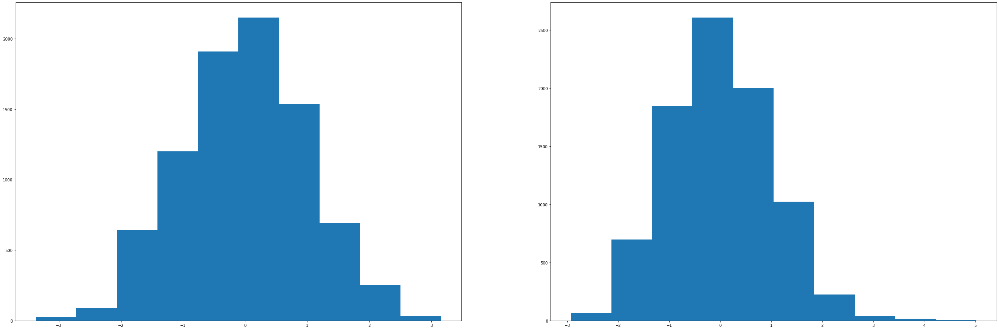

In [22]:
fig = plt.figure(figsize=(45,15))
ax1 = fig.add_subplot(121)
ax2 = fig.add_subplot(122)

x = ax1.hist(df_norm['Depression_Crude_Percent'])
y = ax2.hist(x = df_norm['Mental_Health_Crude_Percent'])

For the next few sections we are going to visualize and look at the correlation between the different parameters and Mental Health/Depression percentage. Correlation is a statistic that tells us the extent to which two variable are related. 
First lets look at the correlation between Mean Income and Mental Health/Depression. To visualize this we will use scatter plots. We will also use least squares method to create lines of best fit for the correlation between the two and add this to our scatter plots  

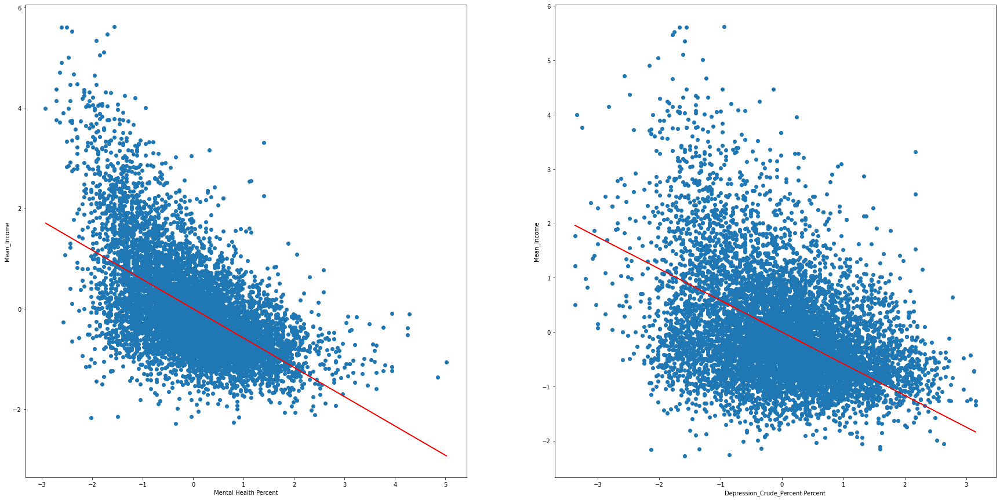

In [23]:
fig = plt.figure(figsize=(30,15))
ax1 = fig.add_subplot(121)
ax2 = fig.add_subplot(122)
m,b = np.polyfit(df_norm['Mental_Health_Crude_Percent'], df_norm['Mean_Income'], 1)
ax1.plot(df_norm['Mental_Health_Crude_Percent'],m*df_norm['Mental_Health_Crude_Percent'] + b, color='red')
a,c = np.polyfit(df_norm['Mental_Health_Crude_Percent'], df_norm['Mean_Income'], 1)
ax2.plot(df_norm['Depression_Crude_Percent'],a*df_norm['Depression_Crude_Percent'] + c, color='red')
ax1.set_xlabel('Mental Health Percent')
ax1.set_ylabel('Mean_Income')
ax2.set_xlabel('Depression_Crude_Percent Percent')
ax2.set_ylabel('Mean_Income')
ax1.scatter(x = df_norm['Mental_Health_Crude_Percent'],y=df_norm['Mean_Income'])
ax2.scatter(x = df_norm['Depression_Crude_Percent'],y=df_norm['Mean_Income'])

There seems to be a negative correlation between the average income of a city and the percent of people with Mental Health and Depression. A negative correlation means that as one rises (Percentage of people with Mental Health issues or Depression), the other falls (Average Income). Although we can visually see it, lets find the actual correlation coefficient to make sure. We can find the correlation coefficient by doing the following.

In [24]:
df_norm['Mental_Health_Crude_Percent'].corr(df_norm['Mean_Income'])

-0.5830666779699206

In [25]:
df_norm['Depression_Crude_Percent'].corr(df_norm['Mean_Income'])

-0.3744007325274011

As we can see from the correlation values above, there is indeed a negative correlation between income and mental health/depression percentage. There is a higher negative correlation between mental health issues and mean income then there is depression and mean income. Using the table below (from : https://www.statology.org/what-is-a-strong-correlation/) we can see that Mental Health Percentage and Mean Income have what would be considered a moderate negative relationship. Depression and Mean Income have a Weak negative relationship. What this means is that as income decreases, mental health issues moderately increase but depression weakly increases.

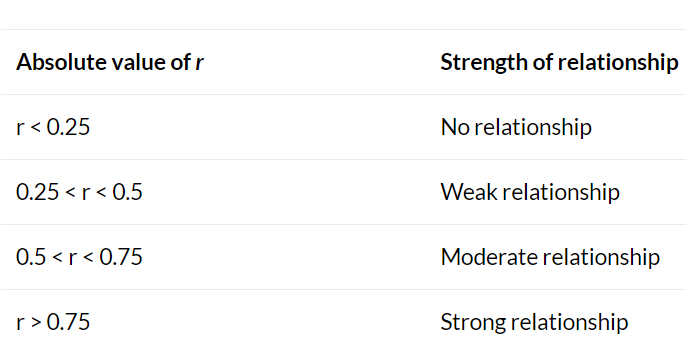

Now lets look at the correlation between Mental Health/Depression and Population. We will basically do the same thing we did with Income vs Mental Health/Depression

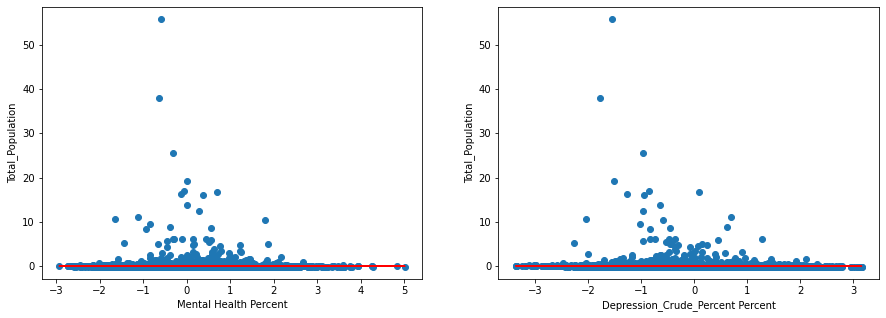

In [26]:
fig = plt.figure(figsize=(15,5))
ax1 = fig.add_subplot(121)
ax2 = fig.add_subplot(122)
m,b = np.polyfit(df_norm['Mental_Health_Crude_Percent'], df_norm['Total_Population'], 1)
ax1.plot(df_norm['Mental_Health_Crude_Percent'],m*df_norm['Mental_Health_Crude_Percent'] + b, color='red')
a,c = np.polyfit(df_norm['Mental_Health_Crude_Percent'], df_norm['Total_Population'], 1)
ax2.plot(df_norm['Depression_Crude_Percent'],a*df_norm['Depression_Crude_Percent'] + c, color='red')
ax1.set_xlabel('Mental Health Percent')
ax1.set_ylabel('Total_Population')
ax2.set_xlabel('Depression_Crude_Percent Percent')
ax2.set_ylabel('Total_Population')
ax1.scatter(x = df_norm['Mental_Health_Crude_Percent'],y=df_norm['Total_Population'])
ax2.scatter(x = df_norm['Depression_Crude_Percent'],y=df_norm['Total_Population'])

The scatter plot for these look very different from the ones before. Using the line we can see that percent of people depression as well as with reported mental health issues seems to be constant as population changes and vice versa. What this means is that there is probably no correlation between the two. Lets calculate it to be sure. 

In [27]:
df_norm['Mental_Health_Crude_Percent'].corr(df_norm['Total_Population'])

-0.007328962189996429

In [28]:
df_norm['Depression_Crude_Percent'].corr(df_norm['Total_Population'])

-0.05909422582877895

As we can see from the values above there is small negative correlation between the two, but it is very very small. What this means is that yes, as population rises, the percent of people with mental health and even moreso depression will decrease, but due to the very small correlation it doesn't seem to be of any significance. Using the table from before, the relation would be considered non existent.

Finally we can try to visualize and see the correlation between Annual Average Temperature and Depression/Mental Health.

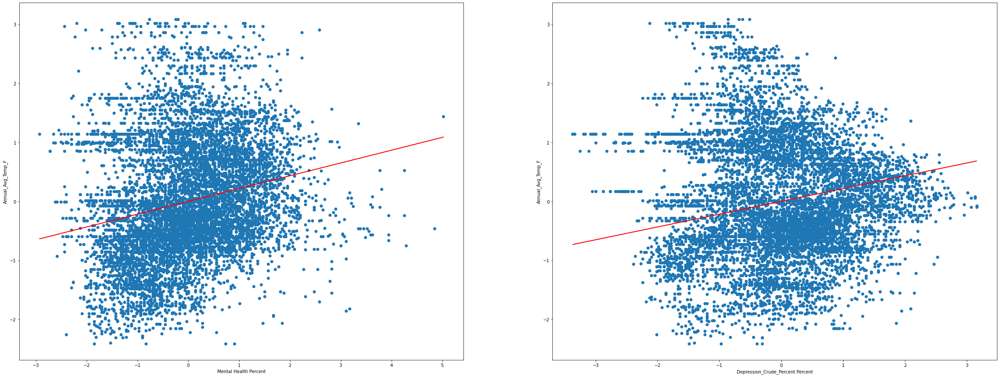

In [29]:
fig = plt.figure(figsize=(40,15))
ax1 = fig.add_subplot(121)
ax2 = fig.add_subplot(122)
m,b = np.polyfit(df_norm['Mental_Health_Crude_Percent'], df_norm['Annual_Avg_Temp_F'], 1)
ax1.plot(df_norm['Mental_Health_Crude_Percent'],m*df_norm['Mental_Health_Crude_Percent'] + b, color='red')
a,c = np.polyfit(df_norm['Mental_Health_Crude_Percent'], df_norm['Annual_Avg_Temp_F'], 1)
ax2.plot(df_norm['Depression_Crude_Percent'],a*df_norm['Depression_Crude_Percent'] + c, color='red')
ax1.set_xlabel('Mental Health Percent')
ax1.set_ylabel('Annual_Avg_Temp_F')
ax2.set_xlabel('Depression_Crude_Percent Percent')
ax2.set_ylabel('Annual_Avg_Temp_F')
ax1.scatter(x = df_norm['Mental_Health_Crude_Percent'],y=df_norm['Annual_Avg_Temp_F'])
ax2.scatter(x = df_norm['Depression_Crude_Percent'],y=df_norm['Annual_Avg_Temp_F'])

There seems to be positive correlation between temperature and mental health/depression percentage. What this would mean is that hotter places have more mental health issues and depression. Lets see the actual correlation coefficients to see if this is the case.

In [30]:
df_norm['Mental_Health_Crude_Percent'].corr(df_norm['Annual_Avg_Temp_F'])

0.21696414062717417

In [31]:
df_norm['Depression_Crude_Percent'].corr(df_norm['Annual_Avg_Temp_F'])

-0.03410921104401688

Now that we see the correlation coefficient, we can see that both of them are under 25% and thus there is no real relationship. 

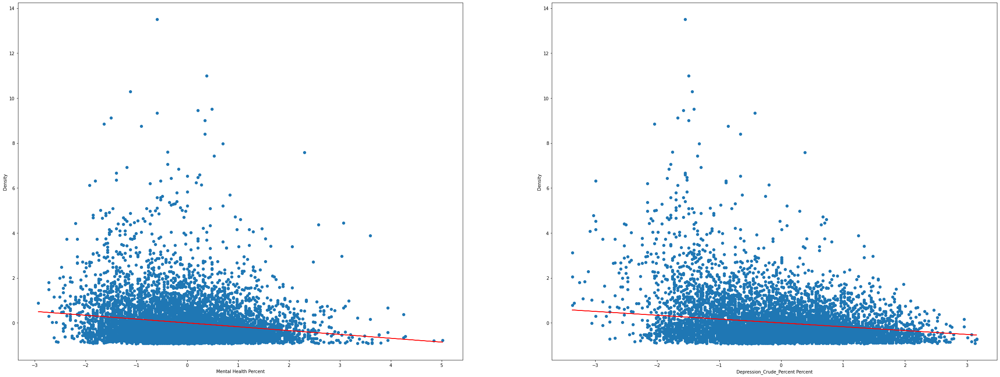

In [32]:
fig = plt.figure(figsize=(40,15))
ax1 = fig.add_subplot(121)
ax2 = fig.add_subplot(122)
m,b = np.polyfit(df_norm['Mental_Health_Crude_Percent'], df_norm['Density'], 1)
ax1.plot(df_norm['Mental_Health_Crude_Percent'],m*df_norm['Mental_Health_Crude_Percent'] + b, color='red')
a,c = np.polyfit(df_norm['Mental_Health_Crude_Percent'], df_norm['Density'], 1)
ax2.plot(df_norm['Depression_Crude_Percent'],a*df_norm['Depression_Crude_Percent'] + c, color='red')
ax1.set_xlabel('Mental Health Percent')
ax1.set_ylabel('Density')
ax2.set_xlabel('Depression_Crude_Percent Percent')
ax2.set_ylabel('Density')
ax1.scatter(x = df_norm['Mental_Health_Crude_Percent'],y=df_norm['Density'])
ax2.scatter(x = df_norm['Depression_Crude_Percent'],y=df_norm['Density'])

With density, there seems to be a negative correlation but again lets look at the coefficient.


In [33]:
df_norm['Mental_Health_Crude_Percent'].corr(df_norm['Density'])

-0.17066868483552633

In [34]:
df_norm['Depression_Crude_Percent'].corr(df_norm['Density'])

-0.30265591775459477

When looking at these, only the correlation between Depression and Density seems to be existent with a weak relationship.
Out of all the four variables that we looked at, the only one that seemed to have a real correlation with Depression and Mental Health Issues was the Income. Temperature and Population don't really seem to have much of an effect, and Density seems to have an effect only on Depression. 

Next, because we have data on the longitudes and latitudes for our cities, we're going to plot our data on a US map! To do this we use folium, which will allow us to plot our points on an interactive map. Each point will have a color correlated to the mental health/depression percent columns we created before. Green means lower percents and red means higher percents.  
  
We'll make a separate plot for each of the four columns we created: Mental health crude percent, mental health age adjusted percent, depression crude percent, and depression age adjusted percent.

In [35]:
import folium

Mental_Health_Age_Adjusted_Map = folium.Map(location=[37.0902, -95.7129], zoom_start=4.45)
Mental_Health_Crude_Map = folium.Map(location=[37.0902, -95.7129], zoom_start=4.45)
Depression_Age_Adjusted_Map = folium.Map(location=[37.0902, -95.7129], zoom_start=4.45)
Depression_Crude_Map = folium.Map(location=[37.0902, -95.7129], zoom_start=4.45)

def mental_health_prod_color(percent):
    if percent < 12:
        return 'darkgreen'    
    elif 12 <= percent < 15 :
        return 'green'
    elif 15 <= percent < 16 :
        return 'yellow'
    elif 16 <= percent < 20:
        return 'orange'
    else:
        return 'red'
    
def depression_prod_color(percent):
    if percent < 15:
        return 'darkgreen'    
    elif 15 <= percent < 20 :
        return 'green'
    elif 20 <= percent < 23 :
        return 'yellow'
    elif 23 <= percent < 25:
        return 'orange'
    else:
        return 'red'

In [ ]:
# for each city in the dataframe, we add a point to one of our four maps based on its percent of its respective column
for index, row in df.iterrows():
    
    # MENTAL HEALTH AGE ADJUSTED
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=2,
        fill = True,
        fill_opacity = .3, # Setting the inner circle opacity
        color = mental_health_prod_color(row['Mental_Health_Age-Adjusted_Percent']),
        opacity = 0.4,
        
        # popup that reveals city and percent on hover
        popup = [row['City'], ': ', row['Mental_Health_Age-Adjusted_Percent']] 
    ).add_to(Mental_Health_Age_Adjusted_Map)
    
    # MENTAL HEALTH CRUDE 
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=2,
        fill = True,
        fill_opacity = .3, # Setting the inner circle opacity
        color = mental_health_prod_color(row['Mental_Health_Crude_Percent']),
        opacity = 0.4,
        popup = [row['City'], ': ', row['Mental_Health_Crude_Percent']] 
    ).add_to(Mental_Health_Crude_Map)
    
    # DEPRESSION AGE ADJUSTED 
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=2,
        fill = True,
        fill_opacity = .3, # Setting the inner circle opacity
        color = depression_prod_color(row['Depression_Age-Adjusted_Percent']),
        opacity = 0.4,
        popup = [row['City'], ': ', row['Depression_Age-Adjusted_Percent']] 
    ).add_to(Depression_Age_Adjusted_Map)
    
    # DEPRESSION CRUDE
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=2,
        fill = True,
        fill_opacity = .3, # Setting the inner circle opacity
        color = depression_prod_color(row['Depression_Crude_Percent']),
        opacity = 0.4,
        popup = [row['City'], ': ', row['Depression_Crude_Percent']] 
    ).add_to(Depression_Crude_Map)
    

In [37]:
Mental_Health_Age_Adjusted_Map

In [38]:
Mental_Health_Crude_Map

In [39]:
Depression_Age_Adjusted_Map

In [ ]:
Depression_Crude_Map

Wow those are some pretty colors, ahem, but what can we decipher from these plots? First, these plots helped reveal that we're missing data for the state of Louisiana, Alaska, and Hawaii. Unfortunately our income dataset didn't have records for these states :(  
  
Besides that, these plots are extremely helpful in revealing to us that there are specific regions that tend to have similar percentages of mental illness and depression. More specifically, we can draw that the southeast region of the United States has very high percentages of mental illness and depression relative to other regions. There are too many factors for us to say for sure what is causing these higher percentages, but we could speculate. Republican party? Landlocked? Rural life?  
  
Another interesting region is the west coast of Oregon and Washington. This region does have moderate percentages of mental illness, but you'll notice that this region has very high percentages of depression. As stated above, there are many factors that could play a role in this, but we can always speculate. Gloomy weather? Higher legalization of recreational drugs?  
  
There are many other regions of interest that we could continue to pick out and explore reasons for their percentages, but at the end of the day, all we can do is speculate :)